In [180]:
import IPython.display as ipd
import numpy as np
import matplotlib.pyplot as plt
import scipy.io.wavfile as wav
import scipy.signal as signal

In [181]:
# Function to apply a bandpass filter to the audio signal
def apply_bandpass_filter(audio, low_freq, high_freq, sample_rate):
    nyquist = 0.5 * sample_rate
    low = low_freq / nyquist
    high = high_freq / nyquist
    b, a = signal.butter(5, [low, high], btype='band')
    filtered_audio = signal.lfilter(b, a, audio)
    return filtered_audio

In [182]:
# Function to increase the volume of the audio signal
def increase_volume(audio, amplification_factor):
    amplified_audio = audio * amplification_factor
    return amplified_audio

In [183]:
# Load the audio file
sample_rate, audio = wav.read('videoplayback.wav')
ipd.Audio('videoplayback.wav')

In [184]:
# Define the frequency range for bird sounds
bird_low_freq = 2000  # Minimum frequency of bird sounds
bird_high_freq = 5000  # Maximum frequency of bird sounds

In [185]:
# Apply the bandpass filter to extract bird sounds
filtered_audio = apply_bandpass_filter(audio, bird_low_freq, bird_high_freq, sample_rate)

In [186]:
# Create a new WAV file with the filtered bird sounds
filtered_filename = 'filtered_audio.wav'
wav.write(filtered_filename, sample_rate, np.int16(filtered_audio))

In [187]:
# Increase the volume of the filtered bird sounds
amplification_factor = 10  # Adjust this factor to increase or decrease the volume
amplified_audio = increase_volume(filtered_audio, amplification_factor)

In [188]:
# Create a new WAV file with the filtered bird sounds
amplified_filename = 'amplified_audio.wav'
wav.write(amplified_filename, sample_rate, np.int16(filtered_audio))

Text(0, 0.5, 'Amplitude')

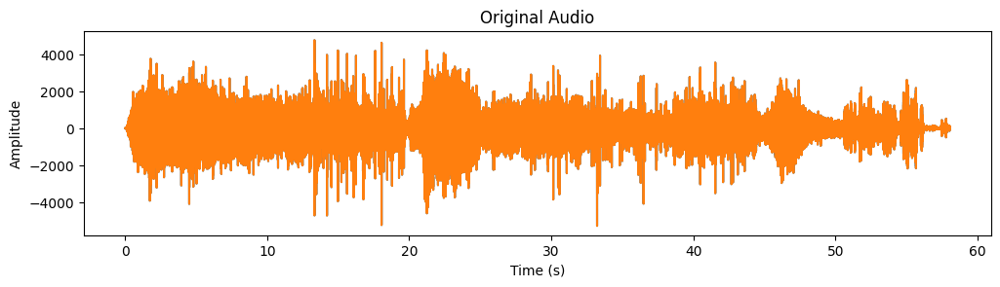

In [189]:
# Plot the original and filtered audio signals
time = np.arange(0, len(audio)) / sample_rate
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(time, audio)
plt.title('Original Audio')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')

Text(0, 0.5, 'Amplitude')

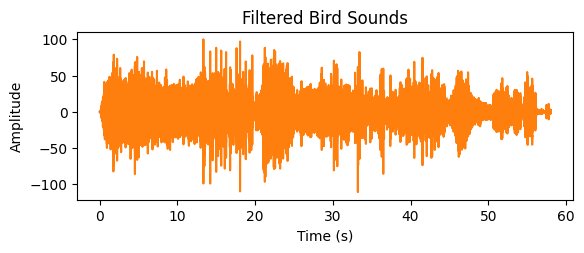

In [190]:
filtered_time = np.arange(0, len(amplified_audio)) / sample_rate
plt.subplot(2, 1, 2)
plt.plot(filtered_time, amplified_audio)
plt.title('Filtered Bird Sounds')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')

In [191]:
plt.tight_layout()
plt.show()

<Figure size 640x480 with 0 Axes>

In [192]:
# Play the filtered bird sounds
ipd.Audio(amplified_filename)